# CycleGAN

The task is to generate Monet-like pictures from real pictures and vise versa: to generate real pictures from Monet's paintings using CycleGAN architecture.

## Dependencies

In [1]:
import os
import glob
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import random
import copy
from tqdm.notebook import tqdm
import itertools

from PIL import Image

%matplotlib inline

sns.set(style='darkgrid', font_scale=1.2)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

## Preparing dataset

Функции для подготовки датасета взял отсюда: https://www.kaggle.com/code/balraj98/cyclegan-translating-paintings-photos-pytorch

In [2]:
class ImageDataset(Dataset):
    def __init__(self, root, transforms_=None, unaligned=False, mode="train"):
        self.transform = tt.Compose(transforms_)
        self.unaligned = unaligned

        self.files_A = sorted(glob.glob(os.path.join(root, f"{mode}A") + "/*.*"))
        self.files_B = sorted(glob.glob(os.path.join(root, f"{mode}B") + "/*.*"))

    def __getitem__(self, index):
        image_A = Image.open(self.files_A[index % len(self.files_A)])

        if self.unaligned:
            image_B = Image.open(self.files_B[random.randint(0, len(self.files_B) - 1)])
        else:
            image_B = Image.open(self.files_B[index % len(self.files_B)])

        item_A = self.transform(image_A)
        item_B = self.transform(image_B)
        return {"A": item_A, "B": item_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

In [3]:
img_height = 256
img_width = 256

dataset_path = "/kaggle/input/monet2photo"

# Image transformations
transforms_ = [
    tt.Resize(int(img_height*1.12), Image.BICUBIC),
    tt.RandomCrop((img_height, img_width)),
    tt.RandomHorizontalFlip(),
    tt.ToTensor(),
    tt.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
]

# Training data loader
train_dataloader = DataLoader(
    ImageDataset(f"{dataset_path}", transforms_=transforms_, unaligned=True),
    batch_size=1,
    shuffle=True,
    num_workers=1,
    pin_memory = True
)
# Test data loader
test_dataloader = DataLoader(
    ImageDataset(f"{dataset_path}", transforms_=transforms_, unaligned=True, mode="test"),
    batch_size=5,
    shuffle=True,
    num_workers=1,
    pin_memory = True
)

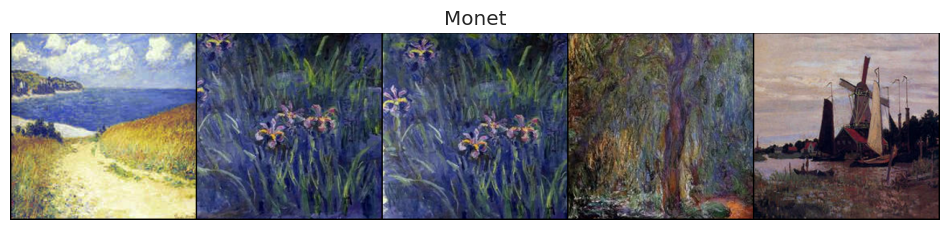

In [4]:
plt.figure(figsize=(12, 12))
plt.axis("off")
plt.title("Monet")

img = next(iter(test_dataloader))["A"]

plt.imshow(make_grid(img, n_row = 5, normalize = True).cpu().permute(1, 2, 0))


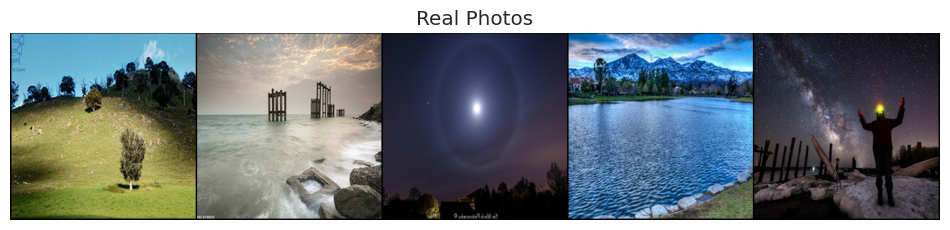

In [5]:
plt.figure(figsize=(12, 12))
plt.axis("off")
plt.title("Real Photos")

img = next(iter(test_dataloader))["B"]

plt.imshow(make_grid(img, n_row = 5, normalize = True).cpu().permute(1, 2, 0))


## Model

In [6]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        
        self.block = nn.Sequential(
            nn.ReflectionPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )
        
    def forward(self, x):
        return x + self.block(x)
    
    
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.generator = nn.Sequential(
            #c7s1-64
            nn.ReflectionPad2d((3, 3, 3, 3)),
            nn.Conv2d(3, 64, 7, stride = 1),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True),
            
            #d128
            nn.Conv2d(64, 128, 3, stride = 2, padding = 1),
            nn.InstanceNorm2d(128),
            nn.ReLU(inplace=True),
            
            #d256
            nn.Conv2d(128, 256, 3, stride = 2, padding = 1),
            nn.InstanceNorm2d(256),
            nn.ReLU(inplace=True),
            
            #R256 * 9
            ResidualBlock(256),
            ResidualBlock(256),
            ResidualBlock(256),
            ResidualBlock(256),
            ResidualBlock(256),
            ResidualBlock(256),
            ResidualBlock(256),
            ResidualBlock(256),
            ResidualBlock(256),
                        
            #u128
            nn.Upsample(scale_factor=2),
            nn.Conv2d(256, 128, 3, stride=1, padding=1),
            nn.InstanceNorm2d(128),
            nn.ReLU(inplace=True),
            
            #u64
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 64, 3, stride=1, padding=1),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True),
            
            #c7s1-3
            nn.ReflectionPad2d((3, 3, 3, 3)),
            nn.Conv2d(64, 3, 7, stride = 1),
            nn.Tanh()
            
        )        
        
    def forward(self, img):
        return self.generator(img)
    
    
    
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.discriminator = nn.Sequential(
            #c64
            nn.Conv2d(3, 64, 4, stride = 2),
            nn.LeakyReLU(0.2, inplace=True),
            
            #c128
            nn.Conv2d(64, 128, 4, stride = 2),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            #c256
            nn.Conv2d(128, 256, 4, stride = 2),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            #c512
            nn.Conv2d(256, 512, 4, stride = 2),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            #1-dimensional output
            nn.Conv2d(512, 1, 4)
        )
        
    def forward(self, img):
        return self.discriminator(img)

## Training

In [7]:
lr = 0.0002
lmda = 10
betas = (0.5, 0.999)
epochs = 8

In [8]:
criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()
criterion_identity = nn.L1Loss()

G_A = Generator().cuda()
G_B = Generator().cuda()
D_A = Discriminator().cuda()
D_B = Discriminator().cuda()

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02) # reset Conv2d's weight(tensor) with Gaussian Distribution
        if hasattr(m, 'bias') and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0) # reset Conv2d's bias(tensor) with Constant(0)
        elif classname.find('BatchNorm2d') != -1:
            torch.nn.init.normal_(m.weight.data, 1.0, 0.02) # reset BatchNorm2d's weight(tensor) with Gaussian Distribution
            torch.nn.init.constant_(m.bias.data, 0.0) # reset BatchNorm2d's bias(tensor) with Constant(0)
    
G_A.apply(weights_init)
G_B.apply(weights_init)
D_A.apply(weights_init)
D_B.apply(weights_init)


optimizer_G = torch.optim.Adam(itertools.chain(G_A.parameters(), 
                                               G_B.parameters()), lr=lr, betas=betas)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=lr, betas=betas)
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=lr, betas=betas)

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 1/8] [G train loss: 4.058904] [G test loss: 3.360453] [D train loss: 0.266373] [D test loss: 0.197031]


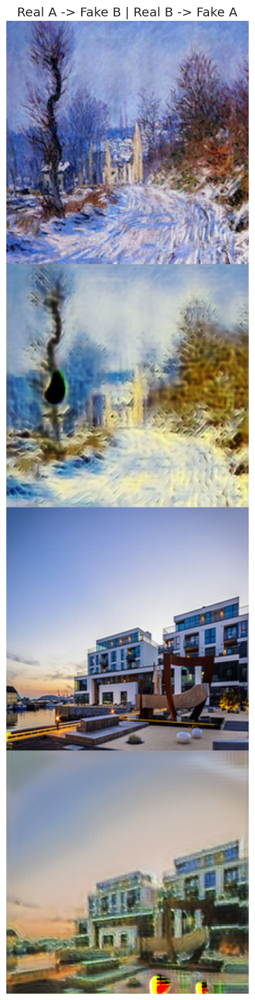

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 2/8] [G train loss: 3.469393] [G test loss: 2.540390] [D train loss: 0.228648] [D test loss: 0.092916]


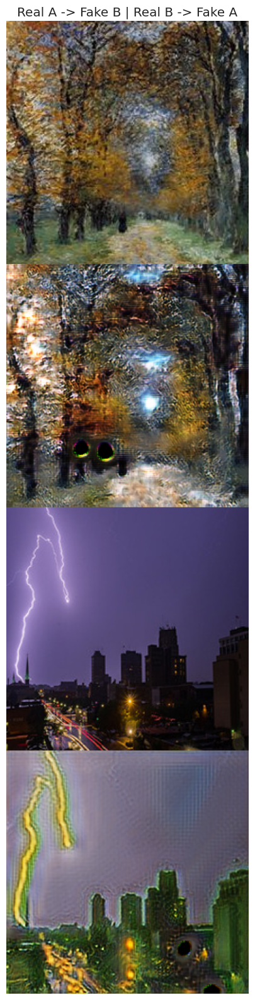

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 3/8] [G train loss: 3.317756] [G test loss: 2.345031] [D train loss: 0.208497] [D test loss: 0.129380]


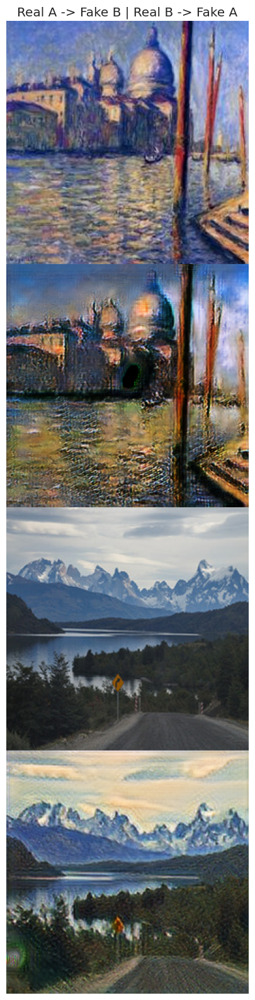

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 4/8] [G train loss: 3.107469] [G test loss: 2.120222] [D train loss: 0.224535] [D test loss: 0.177433]


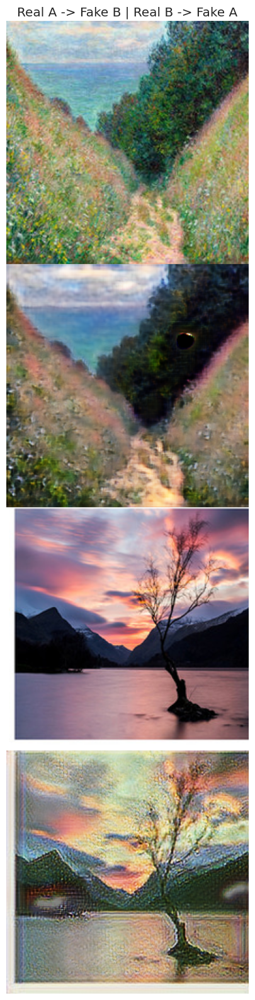

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 5/8] [G train loss: 3.026768] [G test loss: 2.612313] [D train loss: 0.217783] [D test loss: 0.184854]


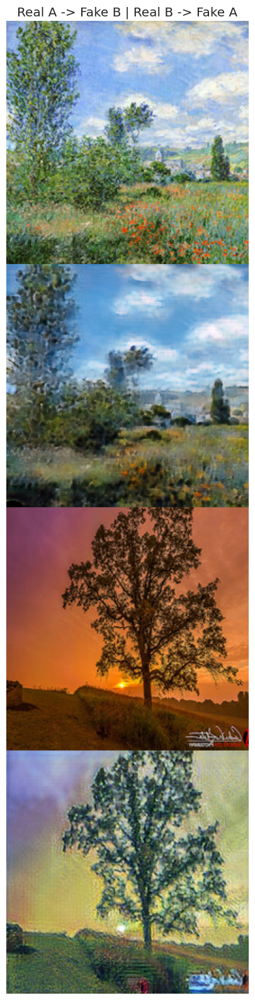

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 6/8] [G train loss: 2.963971] [G test loss: 2.201447] [D train loss: 0.211140] [D test loss: 0.117959]


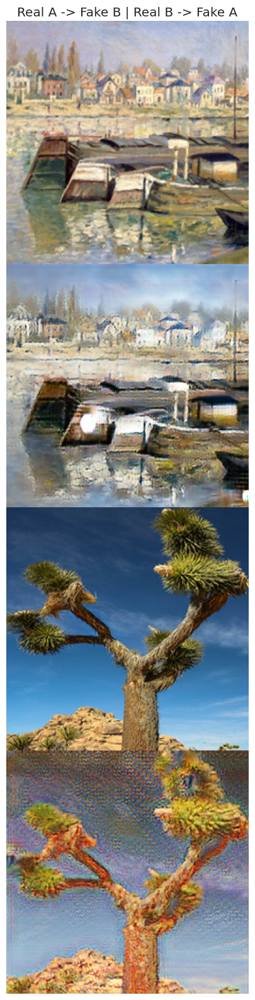

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 7/8] [G train loss: 2.921326] [G test loss: 2.194622] [D train loss: 0.206921] [D test loss: 0.085251]


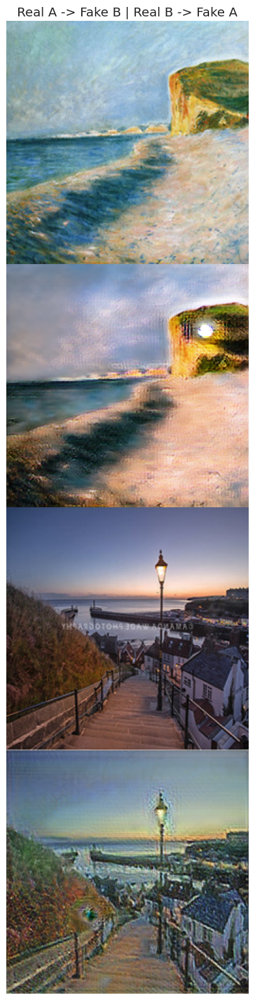

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 8/8] [G train loss: 2.932894] [G test loss: 2.566973] [D train loss: 0.198461] [D test loss: 0.129872]


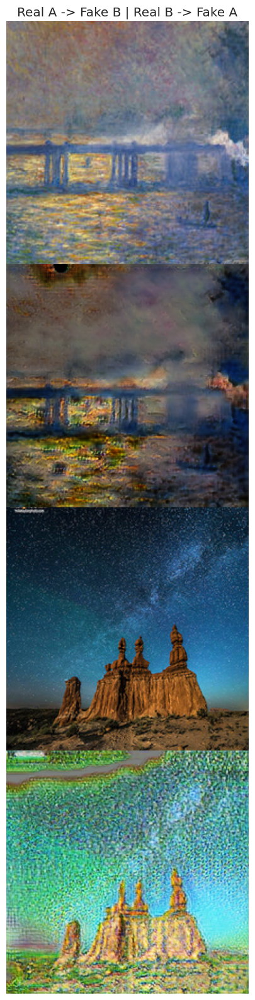

In [9]:
loss_identity_train, loss_cycle_train, loss_GAN_train, loss_G_train ,loss_D_train = [], [], [], [], []
loss_identity_test, loss_cycle_test, loss_GAN_test, loss_G_test, loss_D_test = [], [], [], [], []

for epoch in tqdm(range(1, epochs+1)):
    loss_identity_train_batch, loss_cycle_train_batch, loss_GAN_train_batch, loss_G_train_batch, loss_D_train_batch = [], [], [], [], []
    loss_identity_test_batch, loss_cycle_test_batch, loss_GAN_test_batch, loss_G_test_batch, loss_D_test_batch = [], [], [], [], []
    G_A.train()
    G_B.train()
    D_A.train()
    D_B.train()

    for batch in tqdm(train_dataloader):
        real_a = batch["A"].to(device)
        real_b = batch["B"].to(device)
        
        valid = torch.Tensor(np.ones((real_a.size(0),1, 11, 11))).to(device)
        fake = torch.Tensor(np.zeros((real_a.size(0), 1, 11, 11))).to(device)
        
        # ==================
        # Generator training
        # ==================
        
        optimizer_G.zero_grad()
        
        #identity loss
        loss_identity = (criterion_identity(G_A(real_b), real_b)+criterion_identity(G_B(real_a), real_a))/2
        
        loss_identity_train_batch.append(loss_identity.item())
        
        #GAN loss
        fake_b = G_A(real_a)
        fake_a = G_B(real_b)
        loss_GAN = (criterion_GAN(D_B(fake_b), valid) + criterion_GAN(D_A(fake_a), valid))/2
        
        loss_GAN_train_batch.append(loss_GAN.item())
        
        #cycle loss
        recov_a = G_B(fake_b)
        recov_b = G_A(fake_a)
        loss_cycle = (criterion_cycle(recov_a, real_a) + criterion_cycle(recov_b, real_b))/2
        
        loss_cycle_train_batch.append(loss_cycle.item())
        
        #total loss
        loss_G = loss_GAN + lmda*loss_cycle + lmda/2*loss_identity
        loss_G.backward()
        optimizer_G.step()
        
        loss_G_train_batch.append(loss_G.item())
        
        # ========================
        # Discriminator A training
        # ========================
        optimizer_D_A.zero_grad()
        
        loss_D_A = (criterion_GAN(D_A(real_a), valid) + criterion_GAN(D_A(fake_a.detach()), fake))/2
        loss_D_A.backward()
        optimizer_D_A.step()
        
        # ========================
        # Discriminator B training
        # ========================
        optimizer_D_B.zero_grad()
        
        loss_D_B = (criterion_GAN(D_B(real_b), valid) + criterion_GAN(D_B(fake_b.detach()), fake))/2
        loss_D_B.backward()
        optimizer_D_B.step()
        
        loss_D = (loss_D_A + loss_D_B)/2
        
        loss_D_train_batch.append(loss_D.item())
    
    from statistics import mean
    loss_identity_train.append(mean(loss_identity_train_batch))
    loss_cycle_train.append(mean(loss_cycle_train_batch))
    loss_GAN_train.append(mean(loss_GAN_train_batch))
    loss_G_train.append(mean(loss_G_train_batch))
    loss_D_train.append(mean(loss_D_train_batch))
    
    # =======
    # testing
    # =======
    
    G_A.eval()
    G_B.eval()
    D_A.eval()
    D_B.eval()
    
    for test_batch in test_dataloader:
        real_a = batch["A"].to(device)
        real_b = batch["B"].to(device)
        
        valid = torch.Tensor(np.ones((real_a.size(0),1, 11, 11))).to(device)
        fake = torch.Tensor(np.zeros((real_a.size(0), 1, 11, 11))).to(device)
        with torch.no_grad():
            # ==================
            # Generator test
            # ==================
            
            #identity loss
            loss_identity = (criterion_identity(G_A(real_b), real_b)+criterion_identity(G_B(real_a), real_a))/2

            loss_identity_test_batch.append(loss_identity.item())

            #GAN loss
            fake_b = G_A(real_a)
            fake_a = G_B(real_b)
            loss_GAN = (criterion_GAN(D_B(fake_b), valid) + criterion_GAN(D_A(fake_a), valid))/2
            loss_GAN_test_batch.append(loss_GAN.item())

            #cycle loss
            recov_a = G_B(fake_b)
            recov_b = G_A(fake_a)
            loss_cycle = (criterion_cycle(recov_a, real_a) + criterion_cycle(recov_b, real_b))/2
            loss_cycle_test_batch.append(loss_cycle.item())

            #total loss
            loss_G = loss_GAN + lmda*loss_cycle + lmda/2*loss_identity
            loss_G_test_batch.append(loss_G.item())

            # ========================
            # Discriminator A test
            # ========================

            loss_D_A = (criterion_GAN(D_A(real_a), valid) + criterion_GAN(D_A(fake_a), fake))/2

            # ========================
            # Discriminator B test
            # ========================
            loss_D_B = (criterion_GAN(D_B(real_b), valid) + criterion_GAN(D_B(fake_b), fake))/2
            
            loss_D = (loss_D_A + loss_D_B)/2
            loss_D_test_batch.append(loss_D.item())
    
    
    loss_identity_test.append(mean(loss_identity_test_batch))
    loss_cycle_test.append(mean(loss_cycle_test_batch))
    loss_GAN_test.append(mean(loss_GAN_test_batch))
    loss_G_test.append(mean(loss_G_test_batch))
    loss_D_test.append(mean(loss_D_test_batch))
    
    print('[Epoch %d/%d] [G train loss: %f] [G test loss: %f] [D train loss: %f] [D test loss: %f]'
                    %(epoch,epochs, loss_G_train[-1], loss_G_test[-1], loss_D_train[-1], loss_D_test[-1]
                     ))
    
    real_a = make_grid(real_a, nrow=5, normalize=True)
    fake_b = make_grid(fake_b, nrow=5, normalize=True)
    real_b = make_grid(real_b, nrow=5, normalize=True)
    fake_a = make_grid(fake_a, nrow=5, normalize=True)

    image_grid = torch.cat((real_a, fake_b, real_b, fake_a), 1)
    plt.figure(figsize = (20, 20))
    plt.imshow(image_grid.cpu().permute(1,2,0))
    plt.title('Real A -> Fake B | Real B -> Fake A')
    plt.axis('off')
    plt.show()
    
    # ===============
    # schedulers step
    # ===============
    if epoch == epochs/2:
        scheduler_G = torch.optim.lr_scheduler.PolynomialLR(optimizer_G, total_iters = epochs/2)
        scheduler_D_A = torch.optim.lr_scheduler.PolynomialLR(optimizer_D_A, total_iters = epochs/2)
        scheduler_D_B = torch.optim.lr_scheduler.PolynomialLR(optimizer_D_B, total_iters = epochs/2)
    if epoch > epochs:
        scheduler_G.step()
        scheduler_D_A.step()
        scheduler_D_B.step()

### Visualising results

Text(0.5, 1.0, 'Loss')

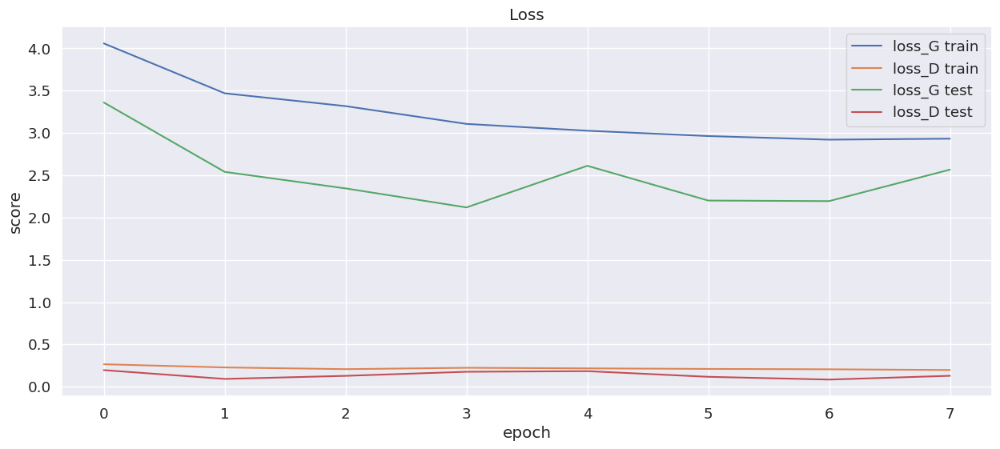

In [10]:
plt.figure(figsize=(15, 6))

plt.plot(loss_G_train, '-')
plt.plot(loss_D_train, '-')
plt.plot(loss_G_test, '-')
plt.plot(loss_D_test, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['loss_G train', 'loss_D train', 'loss_G test', 'loss_D test'])
plt.title('Loss')

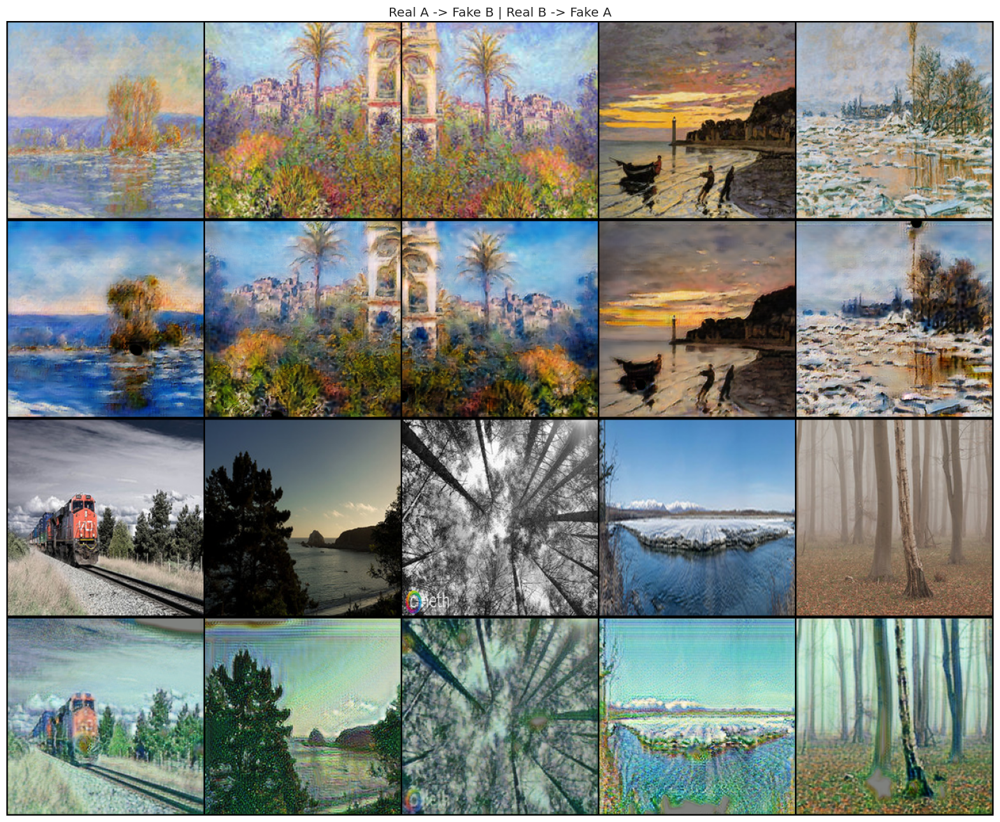

In [11]:
imgs = next(iter(test_dataloader))

G_A.eval()
G_B.eval()

real_a = imgs['A'].to(device)
fake_b = G_A(real_a).detach()
real_b = imgs['B'].to(device)
fake_a = G_B(real_b).detach()

real_a = make_grid(real_a, nrow=5, normalize=True)
fake_b = make_grid(fake_b, nrow=5, normalize=True)
real_b = make_grid(real_b, nrow=5, normalize=True)
fake_a = make_grid(fake_a, nrow=5, normalize=True)
    
image_grid = torch.cat((real_a, fake_b, real_b, fake_a), 1)
plt.figure(figsize = (20, 20))
plt.imshow(image_grid.cpu().permute(1, 2, 0))
plt.title('Real A -> Fake B | Real B -> Fake A')
plt.axis('off')
plt.show()

In [20]:
torch.save(G_A, '/kaggle/working/G_A.pt')
torch.save(G_B, '/kaggle/working/G_B.pt')
torch.save(D_A, '/kaggle/working/D_A.pt')
torch.save(D_B, '/kaggle/working/D_B.pt')

In [12]:
lr = 0.0002
lmda = 10
betas = (0.5, 0.999)
epochs = 2

optimizer_G = torch.optim.Adam(itertools.chain(G_A.parameters(), 
                                               G_B.parameters()), lr=lr, betas=betas)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=lr, betas=betas)
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=lr, betas=betas)

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 9/10] [G train loss: 2.889591] [G test loss: 2.247732] [D train loss: 0.194951] [D test loss: 0.112132]


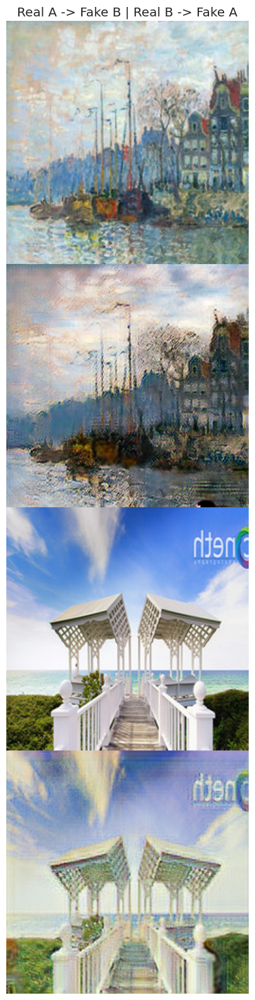

  0%|          | 0/6287 [00:00<?, ?it/s]

[Epoch 10/10] [G train loss: 2.777128] [G test loss: 2.148953] [D train loss: 0.203392] [D test loss: 0.050364]


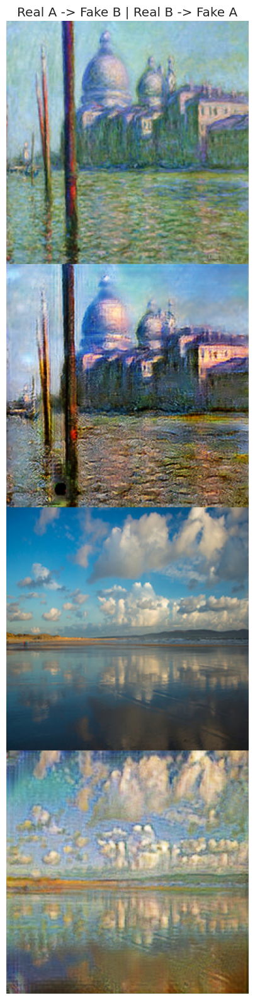

In [13]:
loss_identity_train, loss_cycle_train, loss_GAN_train, loss_G_train ,loss_D_train = [], [], [], [], []
loss_identity_test, loss_cycle_test, loss_GAN_test, loss_G_test, loss_D_test = [], [], [], [], []

for epoch in tqdm(range(1, epochs+1)):
    loss_identity_train_batch, loss_cycle_train_batch, loss_GAN_train_batch, loss_G_train_batch, loss_D_train_batch = [], [], [], [], []
    loss_identity_test_batch, loss_cycle_test_batch, loss_GAN_test_batch, loss_G_test_batch, loss_D_test_batch = [], [], [], [], []
    G_A.train()
    G_B.train()
    D_A.train()
    D_B.train()

    for batch in tqdm(train_dataloader):
        real_a = batch["A"].to(device)
        real_b = batch["B"].to(device)
        
        valid = torch.Tensor(np.ones((real_a.size(0),1, 11, 11))).to(device)
        fake = torch.Tensor(np.zeros((real_a.size(0), 1, 11, 11))).to(device)
        
        # ==================
        # Generator training
        # ==================
        
        optimizer_G.zero_grad()
        
        #identity loss
        loss_identity = (criterion_identity(G_A(real_b), real_b)+criterion_identity(G_B(real_a), real_a))/2
        
        loss_identity_train_batch.append(loss_identity.item())
        
        #GAN loss
        fake_b = G_A(real_a)
        fake_a = G_B(real_b)
        loss_GAN = (criterion_GAN(D_B(fake_b), valid) + criterion_GAN(D_A(fake_a), valid))/2
        
        loss_GAN_train_batch.append(loss_GAN.item())
        
        #cycle loss
        recov_a = G_B(fake_b)
        recov_b = G_A(fake_a)
        loss_cycle = (criterion_cycle(recov_a, real_a) + criterion_cycle(recov_b, real_b))/2
        
        loss_cycle_train_batch.append(loss_cycle.item())
        
        #total loss
        loss_G = loss_GAN + lmda*loss_cycle + lmda/2*loss_identity
        loss_G.backward()
        optimizer_G.step()
        
        loss_G_train_batch.append(loss_G.item())
        
        # ========================
        # Discriminator A training
        # ========================
        optimizer_D_A.zero_grad()
        
        loss_D_A = (criterion_GAN(D_A(real_a), valid) + criterion_GAN(D_A(fake_a.detach()), fake))/2
        loss_D_A.backward()
        optimizer_D_A.step()
        
        # ========================
        # Discriminator B training
        # ========================
        optimizer_D_B.zero_grad()
        
        loss_D_B = (criterion_GAN(D_B(real_b), valid) + criterion_GAN(D_B(fake_b.detach()), fake))/2
        loss_D_B.backward()
        optimizer_D_B.step()
        
        loss_D = (loss_D_A + loss_D_B)/2
        
        loss_D_train_batch.append(loss_D.item())
    
    from statistics import mean
    loss_identity_train.append(mean(loss_identity_train_batch))
    loss_cycle_train.append(mean(loss_cycle_train_batch))
    loss_GAN_train.append(mean(loss_GAN_train_batch))
    loss_G_train.append(mean(loss_G_train_batch))
    loss_D_train.append(mean(loss_D_train_batch))
    
    # =======
    # testing
    # =======
    
    G_A.eval()
    G_B.eval()
    D_A.eval()
    D_B.eval()
    
    for test_batch in test_dataloader:
        real_a = batch["A"].to(device)
        real_b = batch["B"].to(device)
        
        valid = torch.Tensor(np.ones((real_a.size(0),1, 11, 11))).to(device)
        fake = torch.Tensor(np.zeros((real_a.size(0), 1, 11, 11))).to(device)
        with torch.no_grad():
            # ==================
            # Generator test
            # ==================
            
            #identity loss
            loss_identity = (criterion_identity(G_A(real_b), real_b)+criterion_identity(G_B(real_a), real_a))/2

            loss_identity_test_batch.append(loss_identity.item())

            #GAN loss
            fake_b = G_A(real_a)
            fake_a = G_B(real_b)
            loss_GAN = (criterion_GAN(D_B(fake_b), valid) + criterion_GAN(D_A(fake_a), valid))/2
            loss_GAN_test_batch.append(loss_GAN.item())

            #cycle loss
            recov_a = G_B(fake_b)
            recov_b = G_A(fake_a)
            loss_cycle = (criterion_cycle(recov_a, real_a) + criterion_cycle(recov_b, real_b))/2
            loss_cycle_test_batch.append(loss_cycle.item())

            #total loss
            loss_G = loss_GAN + lmda*loss_cycle + lmda/2*loss_identity
            loss_G_test_batch.append(loss_G.item())

            # ========================
            # Discriminator A test
            # ========================

            loss_D_A = (criterion_GAN(D_A(real_a), valid) + criterion_GAN(D_A(fake_a), fake))/2

            # ========================
            # Discriminator B test
            # ========================
            loss_D_B = (criterion_GAN(D_B(real_b), valid) + criterion_GAN(D_B(fake_b), fake))/2
            
            loss_D = (loss_D_A + loss_D_B)/2
            loss_D_test_batch.append(loss_D.item())
    
    
    loss_identity_test.append(mean(loss_identity_test_batch))
    loss_cycle_test.append(mean(loss_cycle_test_batch))
    loss_GAN_test.append(mean(loss_GAN_test_batch))
    loss_G_test.append(mean(loss_G_test_batch))
    loss_D_test.append(mean(loss_D_test_batch))
    
    print('[Epoch %d/%d] [G train loss: %f] [G test loss: %f] [D train loss: %f] [D test loss: %f]'
                    %(epoch + 8,epochs + 8, loss_G_train[-1], loss_G_test[-1], loss_D_train[-1], loss_D_test[-1]
                     ))
    
    real_a = make_grid(real_a, nrow=5, normalize=True)
    fake_b = make_grid(fake_b, nrow=5, normalize=True)
    real_b = make_grid(real_b, nrow=5, normalize=True)
    fake_a = make_grid(fake_a, nrow=5, normalize=True)

    image_grid = torch.cat((real_a, fake_b, real_b, fake_a), 1)
    plt.figure(figsize = (20, 20))
    plt.imshow(image_grid.cpu().permute(1,2,0))
    plt.title('Real A -> Fake B | Real B -> Fake A')
    plt.axis('off')
    plt.show()
    

Text(0.5, 1.0, 'Loss')

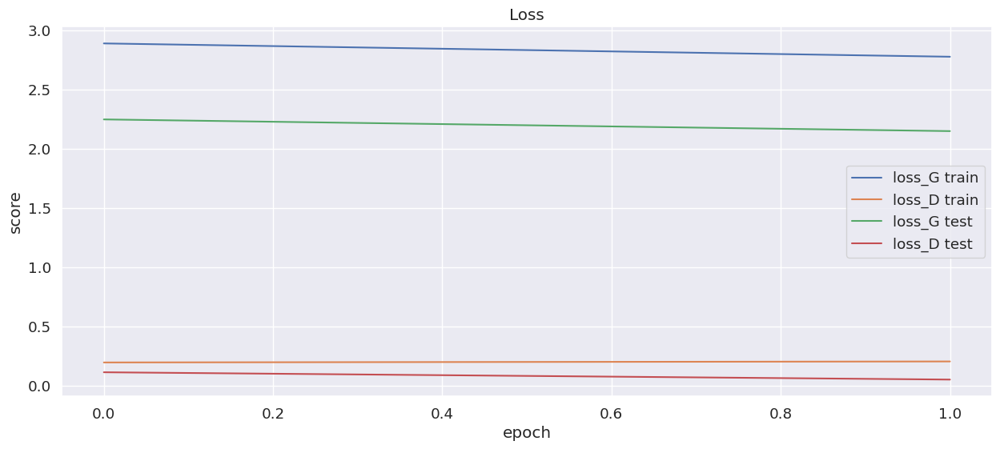

In [14]:
plt.figure(figsize=(15, 6))

plt.plot(loss_G_train, '-')
plt.plot(loss_D_train, '-')
plt.plot(loss_G_test, '-')
plt.plot(loss_D_test, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['loss_G train', 'loss_D train', 'loss_G test', 'loss_D test'])
plt.title('Loss')

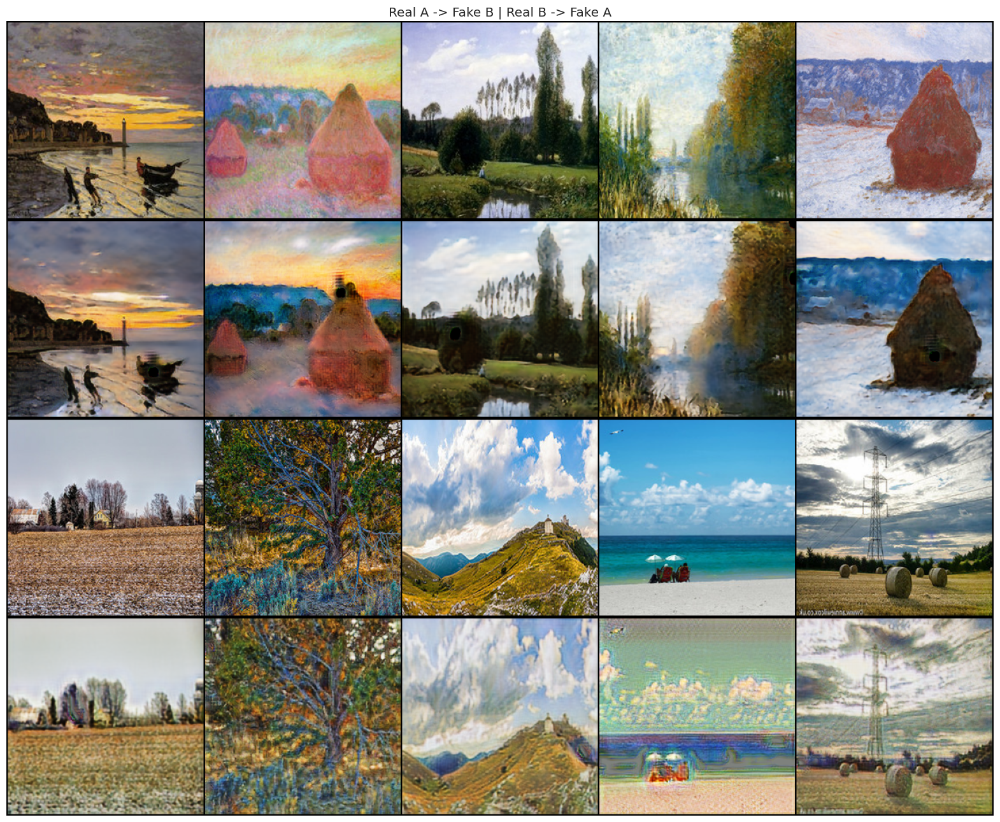

In [15]:
imgs = next(iter(test_dataloader))

G_A.eval()
G_B.eval()

real_a = imgs['A'].to(device)
fake_b = G_A(real_a).detach()
real_b = imgs['B'].to(device)
fake_a = G_B(real_b).detach()

real_a = make_grid(real_a, nrow=5, normalize=True)
fake_b = make_grid(fake_b, nrow=5, normalize=True)
real_b = make_grid(real_b, nrow=5, normalize=True)
fake_a = make_grid(fake_a, nrow=5, normalize=True)
    
image_grid = torch.cat((real_a, fake_b, real_b, fake_a), 1)
plt.figure(figsize = (20, 20))
plt.imshow(image_grid.cpu().permute(1, 2, 0))
plt.title('Real A -> Fake B | Real B -> Fake A')
plt.axis('off')
plt.show()